In [1]:
import os

import torch
from PIL import Image

%run scorers.py

/home/bangbang/miniconda3/envs/kohya/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
2023-08-20 20:14:07.221610: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-08-20 20:14:07.427646: E tensorflow/stream_executor/cuda/cuda_blas.cc:2981] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2023-08-20 20:14:07.856729: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open share

In [2]:
A = torch.rand((3, 3, 512, 512)).cuda()

In [3]:
ims = []
ex_path = '../../../data_examples/real/'

for image in os.listdir(ex_path):
    ims.append(Image.open(os.path.join(ex_path, image)))

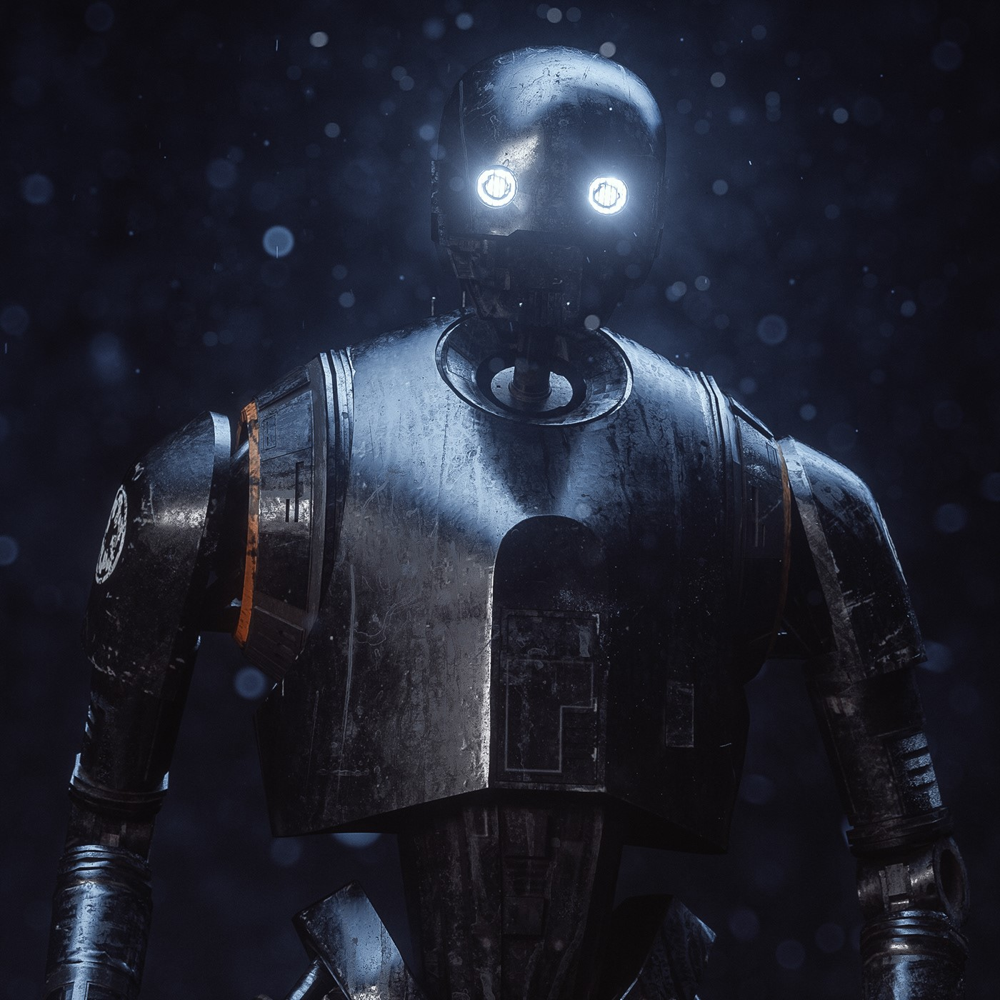

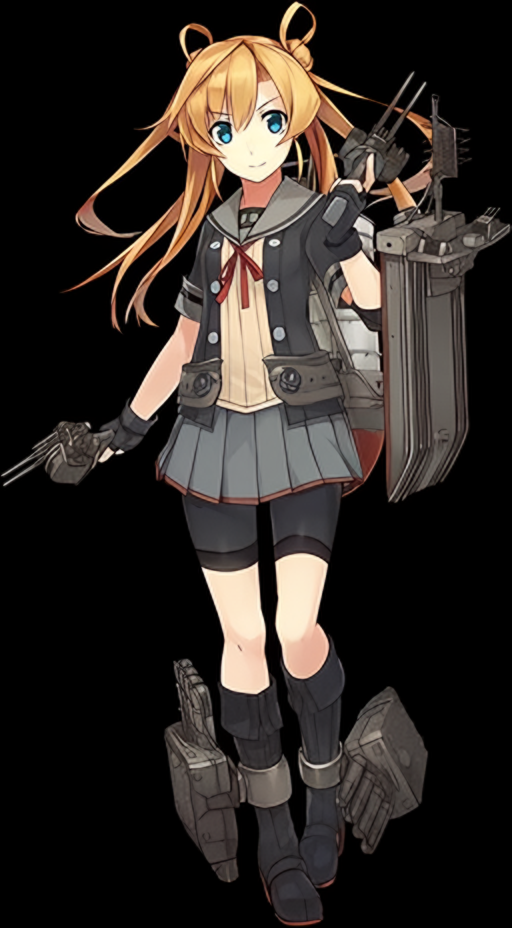

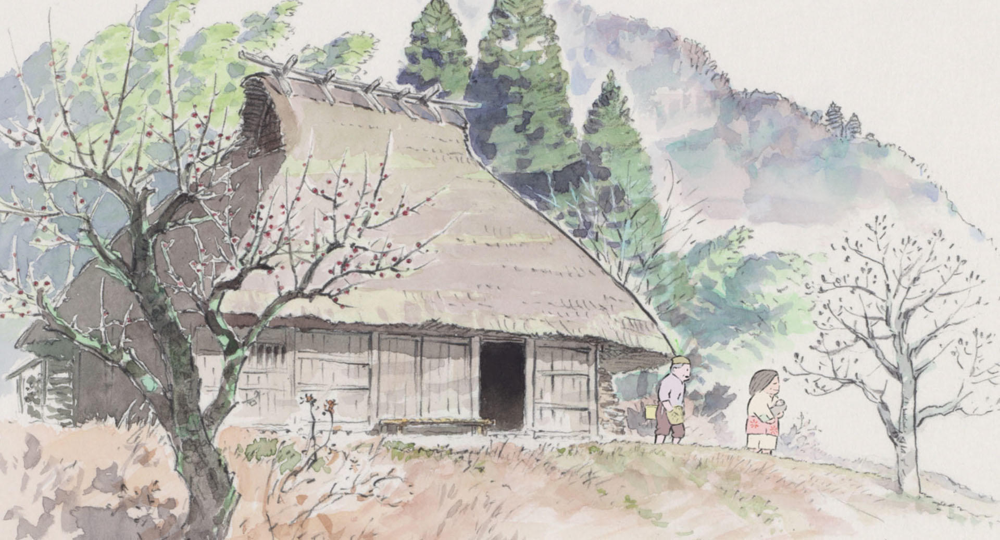

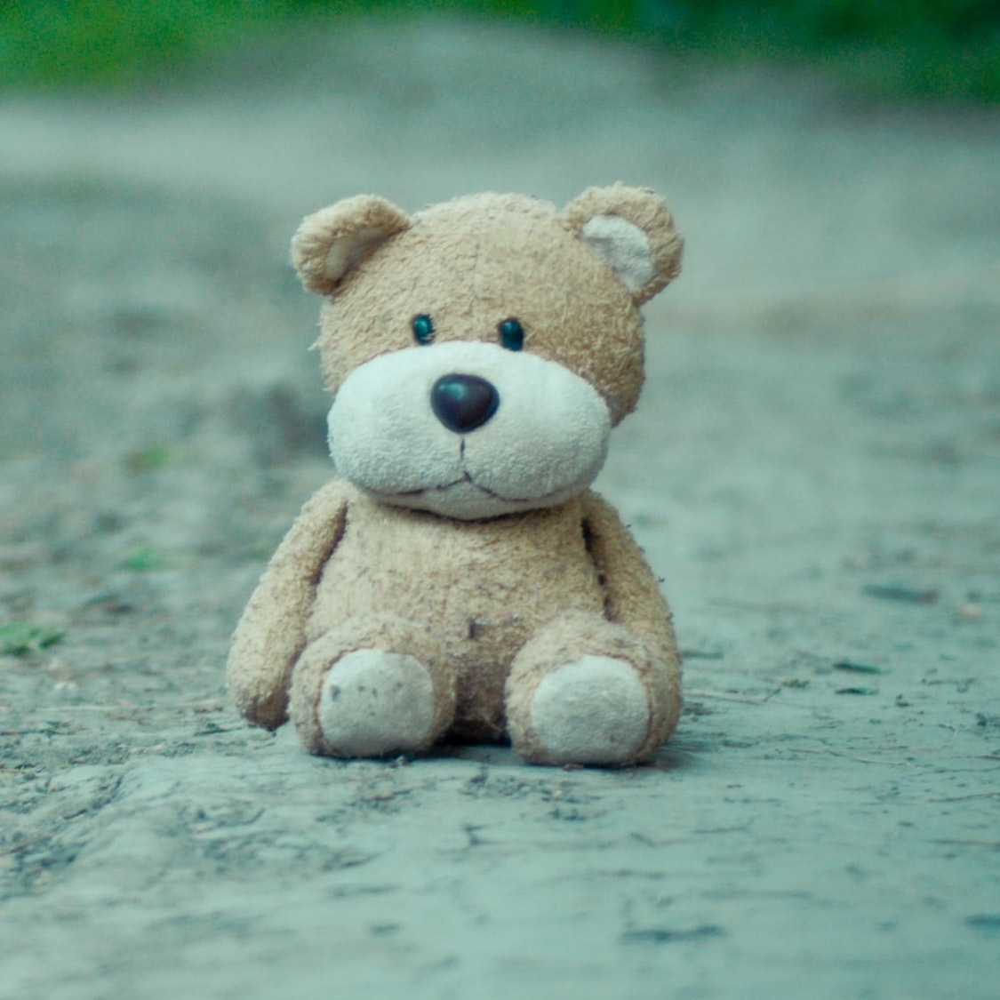

In [4]:
for im in ims:
    display(im)

In [5]:
def add_gaussian_noise(image, mean=0, std=15):
    """
    Add Gaussian noise to an image.

    Parameters:
    - image: PIL Image object
    - mean: Mean of the Gaussian distribution
    - std: Standard deviation of the Gaussian distribution

    Returns:
    - noisy_image: PIL Image object with added noise
    """
    # Convert PIL image to numpy array
    im_arr = np.array(image)
    
    # Generate Gaussian noise
    noise = np.random.normal(mean, std, im_arr.shape).astype('uint8')
    
    # Add the noise to the image
    noisy_arr = np.clip(im_arr + noise, 0, 255).astype('uint8')
    
    # Convert back to PIL image
    noisy_image = Image.fromarray(noisy_arr)

    return noisy_image

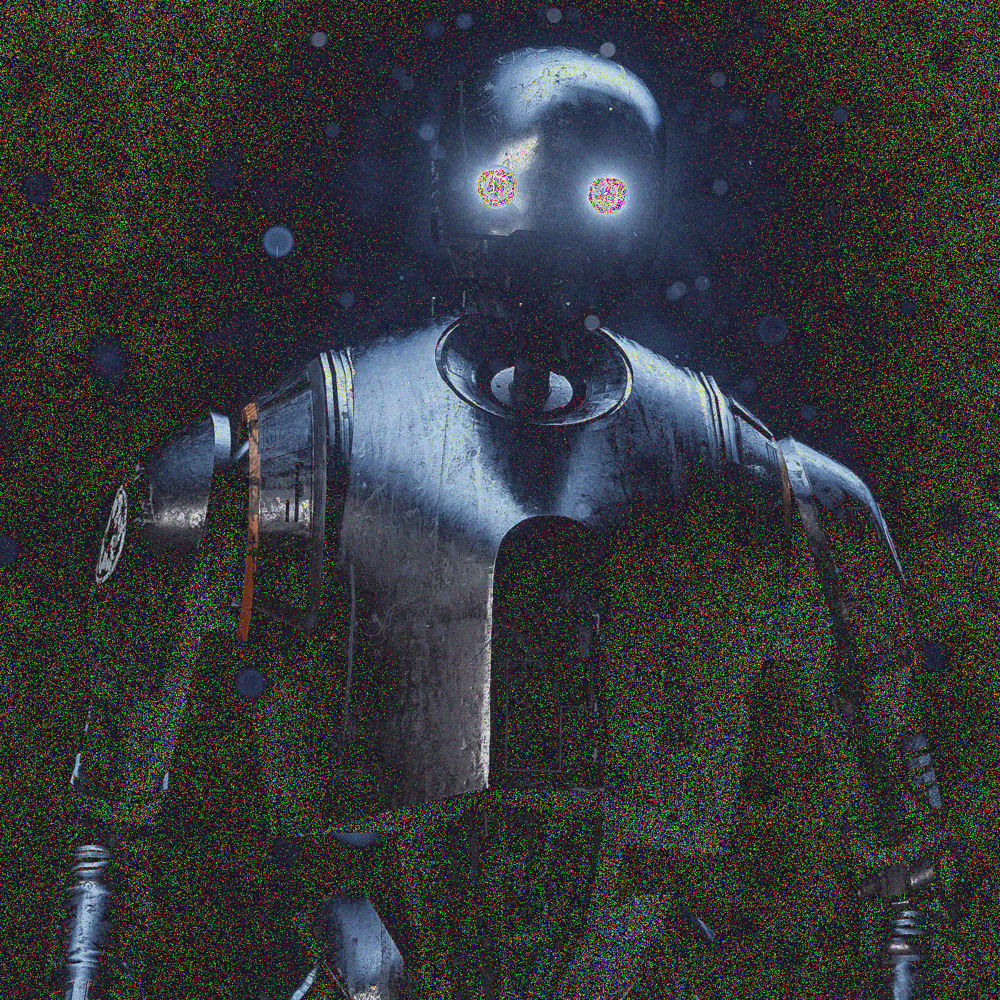

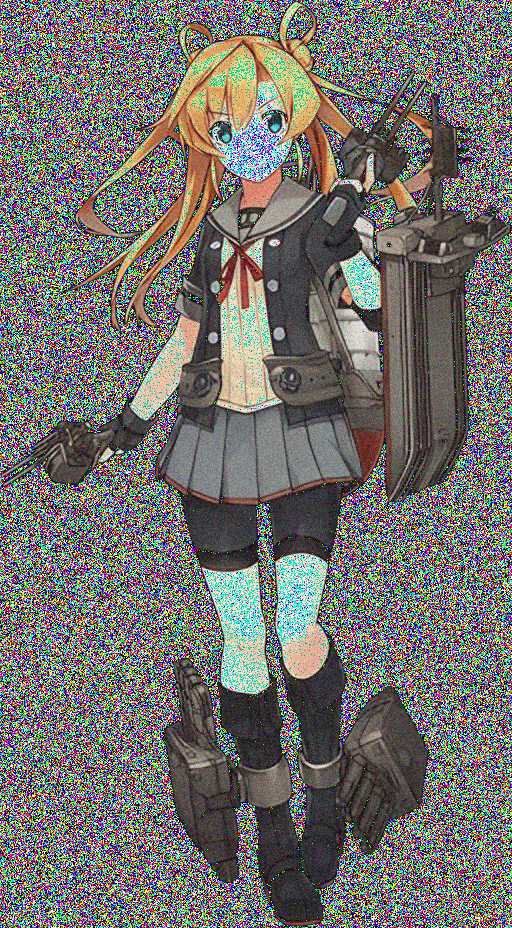

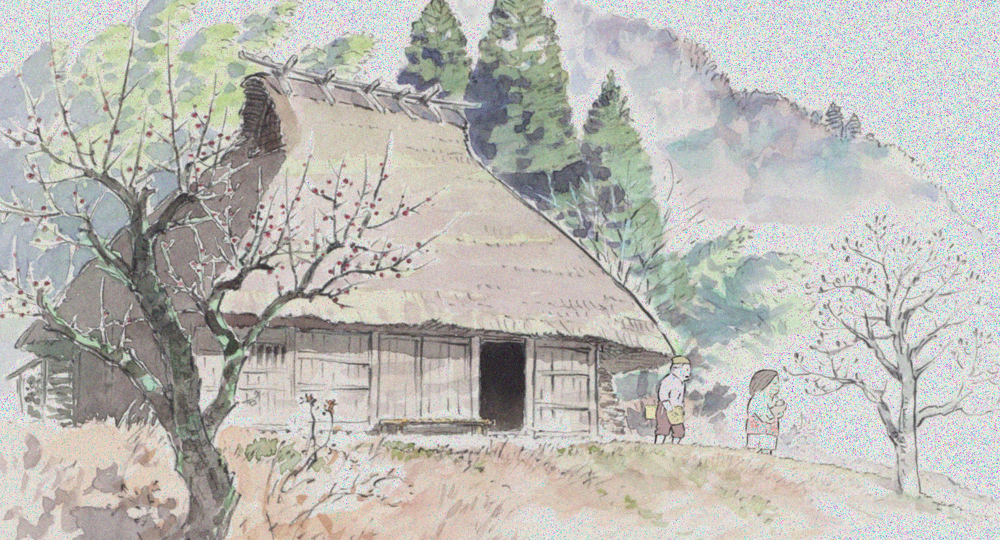

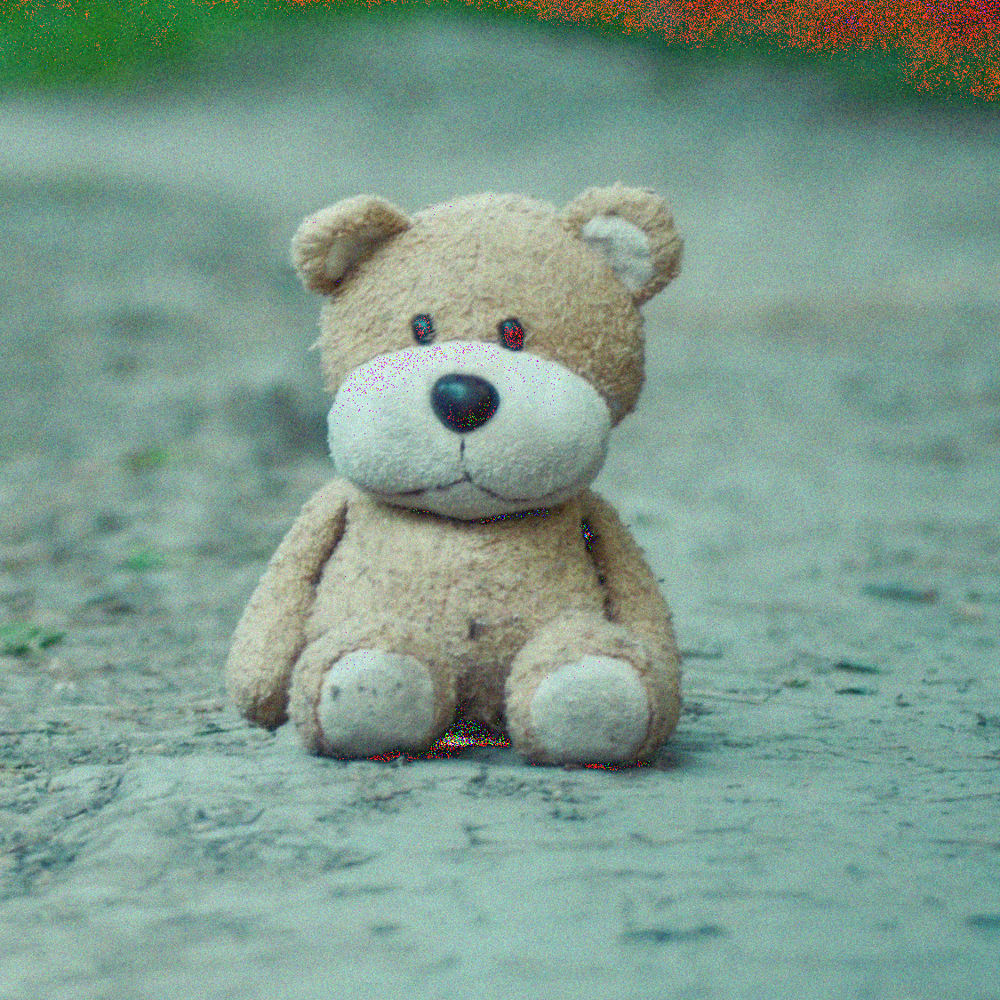

In [6]:
noisy_ims = []

for im in ims:
    noisy_im = add_gaussian_noise(im)
    display(noisy_im)
    noisy_ims.append(noisy_im)

## Scorers

In [7]:
scorer = LiqeScorer('../checkpoints/LIQE.pt', resize_mode='padding')

Warning, padding is used while the model can accept rectangle input


In [5]:
scorer(A)

tensor([2.6641, 2.6680, 2.6523], device='cuda:0', dtype=torch.float16,
       grad_fn=<AddBackward0>)

In [8]:
tfs = scorer.transform
tensors = []
for im in ims:
    tensor = tfs(im).cuda()
    print(scorer(tensor.unsqueeze(0)))
    tensors.append(tensor)
print(scorer(torch.stack(tensors)))

tensor([3.1133], device='cuda:0', dtype=torch.float16, grad_fn=<AddBackward0>)
tensor([3.0898], device='cuda:0', dtype=torch.float16, grad_fn=<AddBackward0>)
tensor([2.4961], device='cuda:0', dtype=torch.float16, grad_fn=<AddBackward0>)
tensor([2.8496], device='cuda:0', dtype=torch.float16, grad_fn=<AddBackward0>)
tensor([3.0273, 3.1387, 2.5254, 2.9023], device='cuda:0', dtype=torch.float16,
       grad_fn=<AddBackward0>)


In [9]:
tfs = scorer.transform
tensors = []
for im in noisy_ims:
    tensor = tfs(im).cuda()
    print(scorer(tensor.unsqueeze(0)))
    tensors.append(tensor)
print(scorer(torch.stack(tensors)))

tensor([2.8125], device='cuda:0', dtype=torch.float16, grad_fn=<AddBackward0>)
tensor([2.8027], device='cuda:0', dtype=torch.float16, grad_fn=<AddBackward0>)
tensor([2.5781], device='cuda:0', dtype=torch.float16, grad_fn=<AddBackward0>)
tensor([2.8223], device='cuda:0', dtype=torch.float16, grad_fn=<AddBackward0>)
tensor([2.7891, 2.8359, 2.4473, 2.8320], device='cuda:0', dtype=torch.float16,
       grad_fn=<AddBackward0>)


In [10]:
scorer = ManiqaScorer('../checkpoints/ckpt_koniq10k.pt', resize_mode='resize')

/home/bangbang/miniconda3/envs/kohya/lib/python3.10/site-packages/safetensors/torch.py:98: UserWarning: TypedStorage is deprecated. It will be removed in the future and UntypedStorage will be the only storage class. This should only matter to you if you are using storages directly.  To access UntypedStorage directly, use tensor.untyped_storage() instead of tensor.storage()
  with safe_open(filename, framework="pt", device=device) as f:
/home/bangbang/miniconda3/envs/kohya/lib/python3.10/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


In [6]:
scorer(A, n_patches=10)

tensor([0.3739, 0.3703, 0.3679], device='cuda:0', grad_fn=<MeanBackward1>)

In [10]:
torch.cuda.empty_cache()

In [9]:
tfs = scorer.transform
tensors = []
for im in ims:
    tensor = tfs(im).cuda()
    print(scorer(tensor.unsqueeze(0), n_patches=10))
    tensors.append(tensor)

tensor([0.3948], device='cuda:0', grad_fn=<MeanBackward1>)
tensor([0.4324], device='cuda:0', grad_fn=<MeanBackward1>)
tensor([0.2794], device='cuda:0', grad_fn=<MeanBackward1>)
tensor([0.3500], device='cuda:0', grad_fn=<MeanBackward1>)


In [11]:
tfs = scorer.transform
tensors = []
for im in noisy_ims:
    tensor = tfs(im).cuda()
    print(scorer(tensor.unsqueeze(0), n_patches=10))
    tensors.append(tensor)

tensor([0.2637], device='cuda:0', grad_fn=<MeanBackward1>)
tensor([0.2499], device='cuda:0', grad_fn=<MeanBackward1>)
tensor([0.2467], device='cuda:0', grad_fn=<MeanBackward1>)
tensor([0.3127], device='cuda:0', grad_fn=<MeanBackward1>)


In [12]:
scorer = ArtifactScorer(
    '../checkpoints/aesthetics_scorer_artifacts_openclip_vit_l_14.pth',
    resize_mode='padding', image_size=224)

In [17]:
B = torch.rand((3, 3, 224, 224)).cuda()
scorer(B)

tensor([2.3940, 2.3721, 2.3974], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)

In [14]:
tfs = scorer.transform
tensors = []
for im in ims:
    tensor = tfs(im).cuda()
    print(scorer(tensor.unsqueeze(0)))
    tensors.append(tensor)
print(scorer(torch.stack(tensors)))

tensor([1.2620], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
tensor([3.0253], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
tensor([1.8656], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
tensor([1.6723], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
tensor([1.2620, 3.0253, 1.8656, 1.6723], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)


In [13]:
tfs = scorer.transform
tensors = []
for im in noisy_ims:
    tensor = tfs(im).cuda()
    print(scorer(tensor.unsqueeze(0)))
    tensors.append(tensor)
print(scorer(torch.stack(tensors)))

tensor([1.8311], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
tensor([3.9706], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
tensor([2.2006], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
tensor([1.9272], device='cuda:0', grad_fn=<ReshapeAliasBackward0>)
tensor([1.8311, 3.9706, 2.2006, 1.9272], device='cuda:0',
       grad_fn=<ReshapeAliasBackward0>)
